In [1]:
import pandas as pd
import numpy as np
import geopandas as gpd
from matplotlib import pyplot as plt
%matplotlib inline

In [2]:
# hurricane evacuation centers from NYC Open Data
hurricane_evac_centers = gpd.read_file('data/Hurricane_Evacuation_Centers.geojson')

# check first five rows
hurricane_evac_centers.head()

,zip_code,city,bldg_add,state,bldg_name,bbl,borocode,bin,accessible,geometry
0,10451,Bronx,244 E 163 Street,NY,"HS Of Law, Gov't & Justice - X",2024450006,2,2109459,Y,POINT (-73.91902 40.82748)
1,10468,Bronx,2780 Reservoir Avenue,NY,Walton HS - X,2032470070,2,2015241,Y,POINT (-73.89704 40.86993)
2,10466,Bronx,921 E 228 Street,NY,I.S./H.S. 362 - Bronx,2048640035,2,2064589,Y,POINT (-73.85267 40.88822)
3,10453,Bronx,1780 Dr. Martin Luther King Jr. Blvd,NY,Morris Heights Educational Complex - Bronx,2028660105,2,2008470,Y,POINT (-73.91524 40.85005)
4,10452,Bronx,1220 Gerard Avenue,NY,P.S./I.S. 218 - Bronx,2024800008,2,2097130,Y,POINT (-73.91966 40.83549)


In [3]:
# How many centers are there?
len(hurricane_evac_centers)

60

In [4]:
# Trim data to the columns needed
hurricane_evac_centers = hurricane_evac_centers[['bldg_add', 'bldg_name', 'borocode', 'geometry']]

In [5]:
# Create new column for the boro name based on boro code

# Dictionary
boro_dict = {'1': 'Manhattan', '2': 'Bronx', '3': 'Brooklyn', '4': 'Queens', '5': 'Staten Island'}

# Assign according to dictionary
hurricane_evac_centers['boro_name']= hurricane_evac_centers['borocode'].map(boro_dict)


In [6]:
# Rename columns
hurricane_evac_centers = hurricane_evac_centers.rename(columns={"borocode": "Borough_Code", "boro_name": "Borough", "bldg_add": "Building_Address", "bldg_name": "Building_Name"})

In [7]:
# View first rows of data with renamed columns
hurricane_evac_centers.head()

,Building_Address,Building_Name,Borough_Code,geometry,Borough
0,244 E 163 Street,"HS Of Law, Gov't & Justice - X",2,POINT (-73.91902 40.82748),Bronx
1,2780 Reservoir Avenue,Walton HS - X,2,POINT (-73.89704 40.86993),Bronx
2,921 E 228 Street,I.S./H.S. 362 - Bronx,2,POINT (-73.85267 40.88822),Bronx
3,1780 Dr. Martin Luther King Jr. Blvd,Morris Heights Educational Complex - Bronx,2,POINT (-73.91524 40.85005),Bronx
4,1220 Gerard Avenue,P.S./I.S. 218 - Bronx,2,POINT (-73.91966 40.83549),Bronx


In [8]:
# Read in boundaries for the five boroughs of NYC to get their geometries in case I want to map later
boros = gpd.read_file('data/Borough_Boundaries/geo_export_87d285ee-3369-4dfc-8413-c0f867ebac43.shp')

In [9]:
boros

,boro_code,boro_name,shape_area,shape_leng,geometry
0,1.0,Manhattan,6.366208e+08,359993.127161,"MULTIPOLYGON (((-74.01093 40.68449, -74.01193 ..."
1,2.0,Bronx,1.187194e+09,463868.935588,"MULTIPOLYGON (((-73.89681 40.79581, -73.89694 ..."
2,3.0,Brooklyn,1.934174e+09,728195.194837,"MULTIPOLYGON (((-73.86327 40.58388, -73.86381 ..."
3,5.0,Staten Island,1.623631e+09,325924.002252,"MULTIPOLYGON (((-74.05051 40.56642, -74.05047 ..."
4,4.0,Queens,3.040206e+09,900269.281914,"MULTIPOLYGON (((-73.82645 40.59053, -73.82642 ..."


In [10]:
import esri2gpd
import requests

from shapely.geometry import Point

import altair as alt

import seaborn as sns
import hvplot.pandas
import holoviews as hv
from holoviews import opts
hv.extension("bokeh",logo=False)

### Setting the Stage: Where are the Centers Located? 

In [11]:
# Calculate centers by Borough
boros_hurricane_evac_centers = hurricane_evac_centers.groupby(['Borough']).size().reset_index(name="Number_of_Centers")

In [12]:
boros_hurricane_evac_centers

,Borough,Number_of_Centers
0,Bronx,12
1,Brooklyn,17
2,Manhattan,10
3,Queens,16
4,Staten Island,5


In [13]:
boros_hurricane_evac_centers_plot = boros_hurricane_evac_centers.hvplot(x='Borough', y='Number_of_Centers', kind='bar', line_width=2, line_color='navy', legend=False)

In [14]:
boros_hurricane_evac_centers_plot

:Bars   [Borough]   (Number_of_Centers)

In [ ]:
hvplot.save(boros_hurricane_evac_centers_plot, 'boros_hurricane_evac_centers_plot.html')

In [ ]:
# overlay line / scatter based on population per boro?

In [15]:
# Are they near more severe hurricane evacuation zones?

# hurricane evacuation zones from NYC Open Data
hurricane_evac_zones = gpd.read_file('data/Hurricane_Evacuation_Zones.geojson')
hurricane_evac_zones = hurricane_evac_zones.to_crs(epsg=4326)

hurricane_evac_zones = hurricane_evac_zones.rename(columns={"hurricane": "Zone"})
hurricane_evac_zones = hurricane_evac_zones.loc[(hurricane_evac_zones["Zone"] != "X") & (hurricane_evac_zones["Zone"] != "7")]

# check first five rows
hurricane_evac_zones.head()

,Zone,shape_area,shape_leng,geometry
0,1,1331438777.89,2855052.33819,"MULTIPOLYGON (((-74.21178 40.50819, -74.21179 ..."
2,2,851138147.323,1787662.0299,"MULTIPOLYGON (((-74.23843 40.50268, -74.23833 ..."
3,3,390838625.801,1448569.7833,"MULTIPOLYGON (((-74.22929 40.50400, -74.23055 ..."
4,4,484377534.999,1599416.25916,"MULTIPOLYGON (((-74.24885 40.50074, -74.24961 ..."
5,6,541629414.584,2007990.98836,"MULTIPOLYGON (((-74.23826 40.50402, -74.23934 ..."


In [16]:
# Visualize the zones
# Zones
hurricane_evac_zones_map = alt.Chart(hurricane_evac_zones.to_crs(epsg=4326), title="Hurricane Evacuation Zones of NYC").mark_geoshape().encode(
            tooltip=["Zone:N"],
            color=alt.Color("Zone:N", scale=alt.Scale(scheme="darkred")),
        ).properties(width=800, height=600)

In [17]:
hurricane_evac_zones_map

alt.Chart(...)

In [18]:
# crs of 4326 for this altair map
hurricane_evac_centers = hurricane_evac_centers.to_crs(epsg=4326)
boros = boros.to_crs(epsg=4326)

# NYC boro background
background = alt.Chart(boros).mark_geoshape(
    fill='lightgray',
    stroke='white'
).properties(
    width=800,
    height=600
)

# NYC centers
centers_map = alt.Chart(hurricane_evac_centers, title="Hurricane Evacuation Centers Across the Boroughs of NYC").mark_geoshape(stroke="black").encode(
            tooltip=["Building_Name:N", "Building_Address:N", "Borough"],
            color=alt.Color("Borough:N", scale=alt.Scale(scheme="DARK2")),
        ).properties(width=800, height=600)



In [19]:
# centers map
centers_map_final = background + centers_map
centers_map_final

alt.LayerChart(...)

In [20]:
# zones and centers together map

# Zones
hurricane_evac_zones_map = alt.Chart(hurricane_evac_zones.to_crs(epsg=4326), title="Hurricane Evacuation Zones and Evacuation Centers of NYC").mark_geoshape().encode(
            #tooltip=["Zone:N"],
            color=alt.Color("Zone:N", scale=alt.Scale(scheme="darkred"),legend=alt.Legend(title="Zone",labelFontSize = 12,symbolSize = 50,titleFontSize=14)),
        ).properties(width=500, height=400)

# NYC centers
centers_map = alt.Chart(hurricane_evac_centers).mark_geoshape(stroke="black", strokeWidth=0.5, fill="#585858").encode(
            tooltip=["Building_Name:N", "Building_Address:N", "Borough"]
        ).properties(width=800, height=600)
        
zones_centers_map = background + hurricane_evac_zones_map + centers_map
zones_centers_map.configure_title(fontSize=20, anchor="middle")

alt.LayerChart(...)

In [ ]:
centers_map_final.save('centers_map_final.json')
hurricane_evac_zones_map.save('hurricane_evac_zones_map.json')
zones_centers_map.save('zones_centers_map.json')


### NYC Tracts and Demographic Data from Census
Census data - grabbing tracts and other demographics via cenpy

In [21]:
import esri2gpd
import cenpy

In [22]:
# Initialize connection
acs = cenpy.remote.APIConnection("ACSDT5Y2019")

# Set the map service for pulling geometries
acs.set_mapservice("tigerWMS_ACS2019")

Connection to American Community Survey: 5-Year Estimates: Detailed Tables 5-Year(ID: https://api.census.gov/data/id/ACSDT5Y2019)
With MapServer: Census ACS 2019 WMS

Demographics first
Since SVI data encompasses many of the exploratory variables I was interested in already, from cenpy, I'll only extract the total population variable.

In [23]:
# Variables
variables = ["NAME", "B03002_001E"]

In [24]:
# query
tracts_vars_NYstate = acs.query(
    cols=variables,
    geo_unit="tract:*",
    geo_filter={
                "state" : "36",
                "county": "*",
               },
)

In [25]:
# List of only NYC counties
nyc_counties_list = '005', '047', '061', '081', '085'

# Select only the tracts in NYC counties
tracts_vars_NYC = tracts_vars_NYstate.loc[
    tracts_vars_NYstate.county.isin(nyc_counties_list)
].copy()

In [26]:
tracts_vars_NYC.head()

,NAME,B03002_001E,state,county,tract
8,"Census Tract 361, Queens County, New York",2238,36,081,036100
9,"Census Tract 363, Queens County, New York",1771,36,081,036300
10,"Census Tract 371, Queens County, New York",1335,36,081,037100
11,"Census Tract 377, Queens County, New York",3620,36,081,037700
12,"Census Tract 379, Queens County, New York",6851,36,081,037900


In [27]:
# combine columns to create GEOID
tracts_vars_NYC['GEOID']=tracts_vars_NYC['state']+tracts_vars_NYC['county']+tracts_vars_NYC['tract']

In [28]:
tracts_vars_NYC.reset_index(drop=True).head()

,NAME,B03002_001E,state,county,tract,GEOID
0,"Census Tract 361, Queens County, New York",2238,36,081,036100,36081036100
1,"Census Tract 363, Queens County, New York",1771,36,081,036300,36081036300
2,"Census Tract 371, Queens County, New York",1335,36,081,037100,36081037100
3,"Census Tract 377, Queens County, New York",3620,36,081,037700,36081037700
4,"Census Tract 379, Queens County, New York",6851,36,081,037900,36081037900


In [29]:
for variable in variables:
    
    # Convert all variables EXCEPT for NAME to floats
    if variable != "NAME":
        tracts_vars_NYC[variable] = tracts_vars_NYC[variable].astype(float)

Now, geometries

In [30]:
# The base url for the map service API endpoint
acs.mapservice._baseurl

'http://tigerweb.geo.census.gov/arcgis/rest/services/TIGERweb/tigerWMS_ACS2019/MapServer'

In [31]:
## use esri2gpd

# Only nyc
where_clause = "STATE = 36 AND COUNTY IN (005, 047, 061, 081, 085)"

# Create the API url with the layer ID add the end
url = f"{acs.mapservice._baseurl}/8" 

# Query
acs_NYC_tracts = esri2gpd.get(url, where=where_clause)

In [32]:
# Trim
acs_NYC_tracts = acs_NYC_tracts[['NAME', 'geometry', 'GEOID', 'COUNTY', 'TRACT', 'STATE', 'AREALAND']]

In [33]:
acs_NYC_tracts.head()

,NAME,geometry,GEOID,COUNTY,TRACT,STATE,AREALAND
0,Census Tract 63,"POLYGON ((-73.93306 40.82816, -73.93305 40.827...",36005006300,005,006300,36,1045102
1,Census Tract 261,"POLYGON ((-73.93727 40.84448, -73.93752 40.844...",36061026100,061,026100,36,156222
2,Census Tract 14.02,"POLYGON ((-73.98788 40.71741, -73.98837 40.716...",36061001402,061,001402,36,113920
3,Census Tract 225,"POLYGON ((-73.96358 40.82664, -73.96379 40.826...",36061022500,061,022500,36,262466
4,Census Tract 41,"POLYGON ((-73.99942 40.71868, -73.99996 40.718...",36061004100,061,004100,36,191278


Merge tracts geometries with tract variables

In [34]:
# Merge tract geometries with tract variables
merged_NYC_tracts_vars = acs_NYC_tracts.merge(
    tracts_vars_NYC,
    left_on=["STATE", "COUNTY", "TRACT", "GEOID"],
    right_on=["state", "county", "tract", "GEOID"],
)

In [35]:
merged_NYC_tracts_vars.head()

,NAME_x,geometry,GEOID,COUNTY,TRACT,STATE,AREALAND,NAME_y,B03002_001E,state,county,tract
0,Census Tract 63,"POLYGON ((-73.93306 40.82816, -73.93305 40.827...",36005006300,005,006300,36,1045102,"Census Tract 63, Bronx County, New York",4582.0,36,005,006300
1,Census Tract 261,"POLYGON ((-73.93727 40.84448, -73.93752 40.844...",36061026100,061,026100,36,156222,"Census Tract 261, New York County, New York",13145.0,36,061,026100
2,Census Tract 14.02,"POLYGON ((-73.98788 40.71741, -73.98837 40.716...",36061001402,061,001402,36,113920,"Census Tract 14.02, New York County, New York",2941.0,36,061,001402
3,Census Tract 225,"POLYGON ((-73.96358 40.82664, -73.96379 40.826...",36061022500,061,022500,36,262466,"Census Tract 225, New York County, New York",10334.0,36,061,022500
4,Census Tract 41,"POLYGON ((-73.99942 40.71868, -73.99996 40.718...",36061004100,061,004100,36,191278,"Census Tract 41, New York County, New York",7997.0,36,061,004100


In [36]:
# Trim only to certain columns
merged_NYC_tracts_vars_final = merged_NYC_tracts_vars[['geometry', 'GEOID', 'COUNTY', 'TRACT', 'NAME_y', 'B03002_001E', 'AREALAND']]

# Rename column
merged_NYC_tracts_vars_final = merged_NYC_tracts_vars_final.rename(columns={"NAME_y": "Tract_Name_Full", "B03002_001E": "Total_Population"})

In [37]:
# new column - calcuate population density
merged_NYC_tracts_vars_final['Population_Density'] =  merged_NYC_tracts_vars_final['Total_Population']/merged_NYC_tracts_vars_final['AREALAND']

In [38]:
# round population density
merged_NYC_tracts_vars_final = merged_NYC_tracts_vars_final.round(decimals=3)


In [39]:
merged_NYC_tracts_vars_final.head()

,geometry,GEOID,COUNTY,TRACT,Tract_Name_Full,Total_Population,AREALAND,Population_Density
0,"POLYGON ((-73.93306 40.82816, -73.93305 40.827...",36005006300,005,006300,"Census Tract 63, Bronx County, New York",4582.0,1045102,0.004
1,"POLYGON ((-73.93727 40.84448, -73.93752 40.844...",36061026100,061,026100,"Census Tract 261, New York County, New York",13145.0,156222,0.084
2,"POLYGON ((-73.98788 40.71741, -73.98837 40.716...",36061001402,061,001402,"Census Tract 14.02, New York County, New York",2941.0,113920,0.026
3,"POLYGON ((-73.96358 40.82664, -73.96379 40.826...",36061022500,061,022500,"Census Tract 225, New York County, New York",10334.0,262466,0.039
4,"POLYGON ((-73.99942 40.71868, -73.99996 40.718...",36061004100,061,004100,"Census Tract 41, New York County, New York",7997.0,191278,0.042


In [40]:
# remove tracts where population = 0
merged_NYC_tracts_vars_final['Total_Population'] = merged_NYC_tracts_vars_final['Total_Population'].replace(np.nan, 0)
merged_NYC_tracts_vars_final = merged_NYC_tracts_vars_final.loc[~((merged_NYC_tracts_vars_final['Total_Population'] == 0))]
merged_NYC_tracts_vars_final = merged_NYC_tracts_vars_final.loc[~((merged_NYC_tracts_vars_final['Population_Density'] == 0))]

In [41]:
len(merged_NYC_tracts_vars_final)

2100

In [42]:
# Create df version with crs of 3857 for certain mapping
merged_NYC_tracts_vars_final_3857 = merged_NYC_tracts_vars_final.to_crs(epsg=3857)

#### Mapping population density by census tract

In [43]:
from bokeh.models import HoverTool
hover = HoverTool(tooltips=[
    ("Population_Density", "@Population_Density{0.000}"),
    ("Tract_Name_Full", "@Tract_Name_Full"),
    ("Total_Population", "@Total_Population")
 ]) 

In [44]:
# hvplot of tracts, choropleth based on population density
NYC_population_density_hvplot = merged_NYC_tracts_vars_final_3857.hvplot(c='Population_Density',
    geo=True, 
    hover_cols=['Tract_Name_Full', 'Total_Population', 'Population_Density'],
    crs=3857, 
    legend=True,
    width=800, 
    height=600, 
    cmap='Viridis_r').opts(tools=[hover])

NYC_population_density_hvplot=NYC_population_density_hvplot.relabel("Population Density Across NYC Census Tracts")

In [45]:
NYC_population_density_hvplot

:Polygons   [Longitude,Latitude]   (Population_Density,Tract_Name_Full,Total_Population)

In [ ]:
hvplot.save(NYC_population_density_hvplot, 'NYC_population_density_hvplot.html')

In [46]:
# making the simple histogram 
NYC_population_density_hist = alt.Chart(merged_NYC_tracts_vars_final_3857).mark_bar().encode(
    alt.X("Population_Density:Q", bin=False),
    y='count()',
)
NYC_population_density_hist

alt.Chart(...)

In [ ]:
NYC_population_density_hist.save('NYC_population_density_hist.json')

### NYC Social Vulnerability Index

In [47]:
# Read in file containing SVI in all of New York State
# Note that the geometry from this will not be used for census tract mapping; census tract info will be used for future joining
SVI_NYstate = gpd.read_file('data/CDC_SVI_NewYork/SVI2018_NEWYORK_tract.shp')

In [48]:
# List of NYC counties only
NYC_counties_names = ['Bronx', 'Queens', 'Richmond', 'New York', 'Kings']

# select only the tracts in the counties of NYC
SVI_NYC = SVI_NYstate.loc[
    SVI_NYstate.COUNTY.isin(NYC_counties_names)
].copy()

In [49]:
# for SVI, only interested in overall tract summary ranking variable  (RPL_THEMES)
SVI_NYC = SVI_NYC[['FIPS', 'geometry', 'RPL_THEMES', 'RPL_THEME1', 'RPL_THEME2', 'RPL_THEME3', 'RPL_THEME4', 'LOCATION']].reset_index(drop=True)

In [50]:
# replace -999 with 0, then drop those rows
SVI_NYC['RPL_THEMES'] = SVI_NYC['RPL_THEMES'].replace(-999, 0)
SVI_NYC = SVI_NYC.loc[~((SVI_NYC['RPL_THEMES'] == 0))]
SVI_NYC['RPL_THEMES'] = SVI_NYC['RPL_THEMES'].replace(np.nan, 0)


In [51]:
# Rename columns Location to NAME for ease of merging later
SVI_NYC = SVI_NYC.rename(columns={"LOCATION": "Tract_Name_Full", "FIPS":"GEOID", "RPL_THEMES": "SVI_Overall", "RPL_THEME1":"SVI_Socioeconomic", "RPL_THEME2":"SVI_Household_Composition", "RPL_THEME3":"SVI_Minority_Status", "RPL_THEME4":"SVI_Housing_Transport"})

In [52]:
SVI_NYC.head()

,GEOID,geometry,SVI_Overall,SVI_Socioeconomic,SVI_Household_Composition,SVI_Minority_Status,SVI_Housing_Transport,Tract_Name_Full
1,36005000200,"POLYGON ((-73.86522 40.81453, -73.86425 40.814...",0.9201,0.8981,0.9857,0.9392,0.4577,"Census Tract 2, Bronx County, New York"
2,36005000400,"POLYGON ((-73.85870 40.81541, -73.85778 40.815...",0.5707,0.5524,0.5830,0.8093,0.2700,"Census Tract 4, Bronx County, New York"
3,36005001600,"POLYGON ((-73.86246 40.81925, -73.86153 40.819...",0.9452,0.8249,0.9391,0.8666,0.9291,"Census Tract 16, Bronx County, New York"
4,36005001900,"POLYGON ((-73.93094 40.80825, -73.92922 40.809...",0.9434,0.9231,0.7489,0.8258,0.9378,"Census Tract 19, Bronx County, New York"
5,36005002000,"POLYGON ((-73.87050 40.82036, -73.86858 40.820...",0.9421,0.9855,0.9106,0.9085,0.6189,"Census Tract 20, Bronx County, New York"


In [53]:
len(SVI_NYC)

2110

In [54]:
SVI_NYC_layered_hist = alt.Chart(SVI_NYC).transform_fold(
    ['SVI_Socioeconomic', 'SVI_Household_Composition', 'SVI_Minority_Status', 'SVI_Housing_Transport'],
    as_=['SVI Theme', 'Score']
).mark_bar(
    opacity=0.95,
    binSpacing=1
).encode(
    alt.X('Score:Q', bin=alt.Bin(maxbins=10)),
    alt.Y('count()', stack=None),
    alt.Color('SVI Theme:N'))

In [55]:
SVI_NYC_layered_hist

alt.Chart(...)

In [ ]:
# SAVE OUT LAYERED HIST
SVI_NYC_layered_hist.save('SVI_NYC_layered_hist.json')

### Merge the demographic and SVI data frames


In [57]:
# Trim the SVI
SVI_NYC_trimmed = SVI_NYC[['SVI_Overall', 'SVI_Socioeconomic', 'SVI_Household_Composition', 'SVI_Minority_Status', 'SVI_Housing_Transport', 'GEOID']]

# Merge into the demographic data
# Use "TRACT_NAME" — that is the unique identifier here
merged_NYC_tracts_SVI = merged_NYC_tracts_vars_final.merge(SVI_NYC_trimmed, 
                                 how='left', 
                                 left_on='GEOID', 
                                 right_on='GEOID')


In [58]:
merged_NYC_tracts_SVI.head()

,geometry,GEOID,COUNTY,TRACT,Tract_Name_Full,Total_Population,AREALAND,Population_Density,SVI_Overall,SVI_Socioeconomic,SVI_Household_Composition,SVI_Minority_Status,SVI_Housing_Transport
0,"POLYGON ((-73.93306 40.82816, -73.93305 40.827...",36005006300,005,006300,"Census Tract 63, Bronx County, New York",4582.0,1045102,0.004,0.9454,0.8537,0.8837,0.9212,0.9142
1,"POLYGON ((-73.93727 40.84448, -73.93752 40.844...",36061026100,061,026100,"Census Tract 261, New York County, New York",13145.0,156222,0.084,0.9620,0.9366,0.7757,0.9812,0.9244
2,"POLYGON ((-73.98788 40.71741, -73.98837 40.716...",36061001402,061,001402,"Census Tract 14.02, New York County, New York",2941.0,113920,0.026,0.6915,0.5344,0.4335,0.8771,0.6991
3,"POLYGON ((-73.96358 40.82664, -73.96379 40.826...",36061022500,061,022500,"Census Tract 225, New York County, New York",10334.0,262466,0.039,0.8956,0.8332,0.4651,0.8658,0.9401
4,"POLYGON ((-73.99942 40.71868, -73.99996 40.718...",36061004100,061,004100,"Census Tract 41, New York County, New York",7997.0,191278,0.042,0.7315,0.4797,0.1258,0.8796,0.9768


In [59]:
merged_NYC_tracts_SVI['SVI_Overall'] = merged_NYC_tracts_SVI['SVI_Overall'].replace(np.nan, 0)
merged_NYC_tracts_SVI = merged_NYC_tracts_SVI.loc[~((merged_NYC_tracts_SVI['SVI_Overall'] == 0))]

In [60]:
len(merged_NYC_tracts_SVI)

2095

In [98]:
# WRITE - MAKE IT EASIER TO LOAD INTO ANOTHER NOTEBOOK MORE QUICKLY SO I CAN TEST OUT FOLIUM
merged_NYC_tracts_SVI.to_file("merged_NYC_tracts_SVI.geojson", driver='GeoJSON')

In [61]:
# crs for hvplot
merged_NYC_tracts_SVI_3857 = merged_NYC_tracts_SVI.to_crs(epsg=3857)

In [62]:
# HVPLOT
SVI_NYC_map = merged_NYC_tracts_SVI_3857.hvplot(c='SVI_Overall',
    geo=True, 
    hover_cols=['Tract_Name_Full', 'SVI_Overall'],
    crs=3857, 
    legend=True,
    width=800, 
    height=600, 
    cmap='viridis')

SVI_NYC_map = SVI_NYC_map.relabel('Social Vulnerability Index by Census Tract in NYC (2018)')  

In [63]:
SVI_NYC_map

:Polygons   [Longitude,Latitude]   (SVI_Overall,Tract_Name_Full)

In [ ]:
hvplot.save(SVI_NYC_map, 'SVI_NYC_map.html', embed=True)

In [64]:
hurricane_evac_centers_3857 = hurricane_evac_centers.to_crs(epsg=3857)

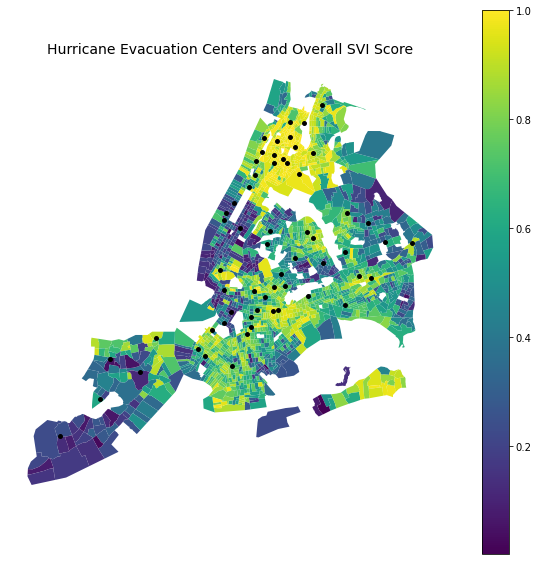

In [65]:
# map SVI by tract and also hurricane evac centers
fig, ax = plt.subplots(figsize=(10,10))


# plot NYC tracts and SVI
merged_NYC_tracts_SVI_3857.plot(column='SVI_Overall', ax=ax, edgecolor='black', cmap='viridis', linewidth=0, legend=True)

# plot centers
hurricane_evac_centers_3857.plot(legend=True, ax=ax, markersize=15, facecolor='black')

# format
ax.set_axis_off()
ax.set_title("Hurricane Evacuation Centers and Overall SVI Score", fontsize=14);



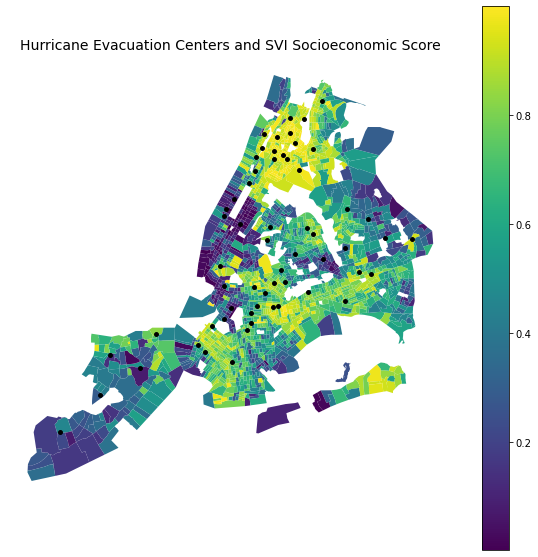

In [66]:
# map SVI by tract and also hurricane evac centers
fig, ax = plt.subplots(figsize=(10,10))

# plot NYC tracts and SVI theme 1
merged_NYC_tracts_SVI_3857.plot(column='SVI_Socioeconomic', ax=ax, edgecolor='black', cmap='viridis', linewidth=0, legend=True)

# plot centers
hurricane_evac_centers_3857.plot(legend=True, ax=ax, markersize=15, facecolor='black')

# format
ax.set_axis_off()
ax.set_title("Hurricane Evacuation Centers and SVI Socioeconomic Score", fontsize=14);

In [ ]:
# map SVI by tract and also hurricane evac centers
fig, ax = plt.subplots(figsize=(10,10))

# plot NYC tracts and SVI theme 1
merged_NYC_tracts_SVI_3857.plot(column='SVI_Household_Composition', ax=ax, edgecolor='black', cmap='viridis', linewidth=0, legend=True)

# plot centers
hurricane_evac_centers_3857.plot(legend=True, ax=ax, markersize=15, facecolor='black')

# format
ax.set_axis_off()
ax.set_title("Hurricane Evacuation Centers and SVI Household Comp Score", fontsize=14);

In [ ]:
# map SVI by tract and also hurricane evac centers
fig, ax = plt.subplots(figsize=(10,10))

# plot NYC tracts and SVI theme 1
merged_NYC_tracts_SVI_3857.plot(column='SVI_Minority_Status', ax=ax, edgecolor='black', cmap='viridis', linewidth=0, legend=True)

# plot centers
hurricane_evac_centers_3857.plot(legend=True, ax=ax, markersize=15, facecolor='black')

# format
ax.set_axis_off()
ax.set_title("Hurricane Evacuation Centers and SVI Minority Status Score", fontsize=14);

In [ ]:
# map SVI by tract and also hurricane evac centers
fig, ax = plt.subplots(figsize=(10,10))

# plot NYC tracts and SVI theme 1
merged_NYC_tracts_SVI_3857.plot(column='SVI_Housing_Transport', ax=ax, edgecolor='black', cmap='viridis', linewidth=0, legend=True)

# plot centers
hurricane_evac_centers_3857.plot(legend=True, ax=ax, markersize=15, facecolor='black')

# format
ax.set_axis_off()
ax.set_title("Hurricane Evacuation Centers and SVI Housing & Transportation Score", fontsize=14);

## Part II: Pandana Network Analysis

In [67]:
import osmnx as ox
import pandana as pnda
from pandana.loaders import osm

In [68]:
# boundary shapefile from OSM
NYC_boundary = ox.geocode_to_gdf('New York City, NY, USA')
NYC_boundary.head() 

,geometry,bbox_north,bbox_south,bbox_east,bbox_west,place_id,osm_type,osm_id,lat,lon,display_name,class,type,importance
0,"MULTIPOLYGON (((-74.25909 40.49721, -74.25903 ...",40.916179,40.477399,-73.700181,-74.25909,282582851,relation,175905,40.712728,-74.006015,"New York, United States",boundary,administrative,1.017577


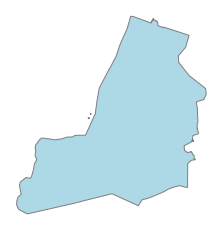

In [69]:
ax = ox.project_gdf(NYC_boundary).plot(fc="lightblue", ec="gray")
ax.set_axis_off()

In [70]:
NYC_boundary_outline = NYC_boundary.geometry.unary_union

In [71]:
# confirm type
type(NYC_boundary_outline)

shapely.geometry.multipolygon.MultiPolygon

In [72]:
# Get bounding box for the city
NYC_boundary_pandana = NYC_boundary_outline.bounds

# Bounds
[lng_min, lat_min, lng_max, lat_max] = NYC_boundary_pandana

In [73]:
# create pandana network - 13min
net = osm.pdna_network_from_bbox(
    lat_min, lng_min, lat_max, lng_max, network_type="walk")

C:\Users\jenna\anaconda3\envs\musa-550-fall-2021\lib\site-packages\osmnet\load.py:445: FutureWarning: Assigning CRS to a GeoDataFrame without a geometry column is now deprecated and will not be supported in the future.
  gdf.crs = crs
C:\Users\jenna\anaconda3\envs\musa-550-fall-2021\lib\site-packages\pyproj\crs\crs.py:68: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  return _prepare_from_string(" ".join(pjargs))


Requesting network data within bounding box from Overpass API in 1 request(s)
Posting to http://www.overpass-api.de/api/interpreter with timeout=180, "{'data': '[out:json][timeout:180];(way["highway"]["highway"!~"motor|proposed|construction|abandoned|platform|raceway"]["foot"!~"no"]["pedestrians"!~"no"](40.47739900,-74.25909000,40.91617850,-73.70018090);>;);out;'}"
Downloaded 175,045.8KB from www.overpass-api.de in 25.12 seconds
Downloaded OSM network data within bounding box from Overpass API in 1 request(s) and 28.93 seconds
Returning OSM data with 1,038,637 nodes and 273,291 ways...
Edge node pairs completed. Took 228.42 seconds
Returning processed graph with 379,396 nodes and 572,065 edges...
Completed OSM data download and Pandana node and edge table creation in 271.80 seconds


In [74]:
hurricane_evac_centers['lon'] = hurricane_evac_centers['geometry'].x
hurricane_evac_centers['lat'] = hurricane_evac_centers['geometry'].y

hurricane_evac_centers_pois = hurricane_evac_centers[['lat', 'lon']]
hurricane_evac_centers_pois= pd.DataFrame(hurricane_evac_centers_pois)

#hurricane_evac_centers_pois['type'] = 'Hurricane_Evac_Center'

In [75]:
hurricane_evac_centers_pois.head()

,lat,lon
0,40.827477,-73.919021
1,40.869934,-73.897044
2,40.888220,-73.852669
3,40.850045,-73.915241
4,40.835493,-73.919665


In [76]:
# Set centers as POIs for the network
net.set_pois(category = 'hurricane_evac_centers_pois',
    maxdist=2000,
    maxitems=3,
    x_col = hurricane_evac_centers_pois.lon,
    y_col = hurricane_evac_centers_pois.lat
)

In [77]:
# Keyword arguments to pass for the matplotlib figure
bbox_aspect_ratio = (lat_max - lat_min) / (lng_max - lng_min)
fig_kwargs = {"facecolor": "w", "figsize": (12, 12 * bbox_aspect_ratio)}

# Keyword arguments to pass for scatter plots
plot_kwargs = {"s": 20, "alpha": 0.9, "cmap": "viridis_r", "edgecolor": "none"}

In [78]:
# only interested in nearest center
num_pois=1

In [79]:
# Access
access = net.nearest_pois(distance=2000, 
                          category='hurricane_evac_centers_pois', 
                          num_pois=1)

In [80]:
# network nodes view
net.nodes_df.head()

,x,y
id,,
30807308,-73.962176,40.792024
30807314,-73.963576,40.790720
30807336,-73.964181,40.788475
30807351,-73.966988,40.785589
30978747,-73.973425,40.774267


In [ ]:
# DON'T RUN THIS CODE UNLESS I WANT TO SAVE THE NETWORK OUT TO CSVs AGAIN

# In case I need it later / things are loading slowly, going to save the network out to a .csv
# Cannot directly save a Pandana network object, but can easily recreate it from the nodes and edges

# net.nodes_df.to_csv('nodes.csv')
# net.edges_df.to_csv('edges.csv')


In [ ]:
# DON'T RUN THIS CODE UNLESS i WANT TO RELOAD THE NETWORK NODES AND EDGES FROM CSVs

#nodes = pd.read_csv('nodes.csv', index_col=0)
#edges = pd.read_csv('edges.csv', index_col=[0,1])

# net = pnda.Network(nodes['x'], nodes['y'], 
#                          edges['from'], edges['to'], edges[['distance']])

In [81]:
# Merge coordinates of network nodes with distances to nearest POIs
nodes = pd.merge(net.nodes_df, access, left_index=True, right_index=True)

# Make into a geodataframe
nodes = gpd.GeoDataFrame(
    nodes, geometry=gpd.points_from_xy(nodes["x"], nodes["y"]), crs="EPSG:4326"
)

# Trim to only boundaries of NYC - use NYC_boundary_outline
nodes = gpd.clip(nodes, NYC_boundary_outline)
nodes = nodes.reset_index(drop=True)

#### Recreate the network graph for mapping - providing context of the walk network available


In [ ]:
# network graph for mapping - 3min
G_NYC = ox.graph_from_polygon(NYC_boundary_outline, network_type='walk')

In [ ]:
# plot the network graph (simple) - 2.5min
ox.plot_graph(ox.project_graph(G_NYC), node_size=0, figsize=(16, 16), edge_color="gray", edge_linewidth=0.25);

# saving this directly out of VSCode as a .png

#### Walking Distance to Nearest Hurricane Evacuation Center in NYC (Matplotlib)

In [82]:
# this function emcompasses some of the code block above, but adds formatting - and if I want to map another type of amenity, allows me to add
def plot_walking_distance(net, amenity, distance=2000, n=1):
    """
    Plot the walking distance to the nearest center
    """
    from mpl_toolkits.axes_grid1 import make_axes_locatable

    # get the distances to nearest num_pois POI
    access = net.nearest_pois(distance=2000, category='hurricane_evac_centers_pois', num_pois=num_pois)

    # merge node positions and distances to nearest POI
    nodes = pd.merge(net.nodes_df, access, left_index=True, right_index=True)
    nodes = gpd.GeoDataFrame(
        nodes, geometry=gpd.points_from_xy(nodes["x"], nodes["y"]), crs="EPSG:4326"
    )

    # Trim to only boundaries of NYC - use NYC_boundary_outline
    nodes = gpd.clip(nodes, NYC_boundary_outline)

    # Create the figure
    fig, ax = plt.subplots(figsize=(12, 12))
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.1)

    # plot the distance to the nth nearest center
    ax = nodes.plot(ax=ax, cax=cax, column=nodes[n], legend=True, **plot_kwargs)

    # add the centers as stars
    for i, row in hurricane_evac_centers_pois.iterrows():
        ax.scatter(row["lon"], row["lat"], color="red", s=10, marker="*")

    # format
    ax.set_facecolor("black")
    ax.figure.set_size_inches(fig_kwargs["figsize"])

    # set extent
    [xmin, ymin, xmax, ymax] = nodes.geometry.total_bounds
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)

    return ax

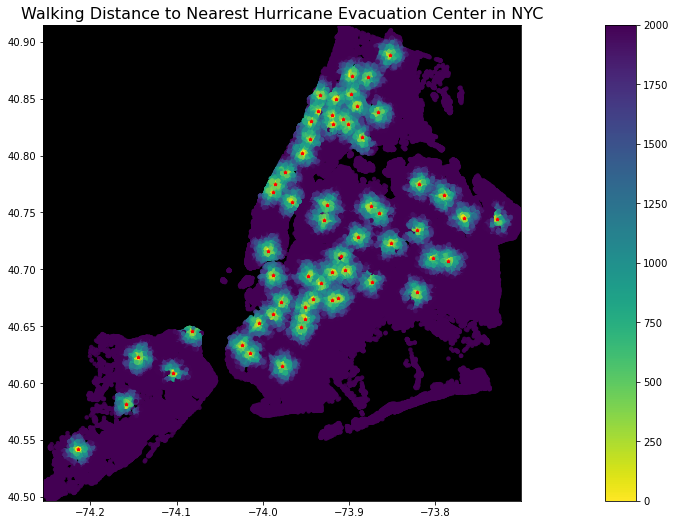

In [83]:
ax = plot_walking_distance(net, "hurricane_evac_centers_pois", n=1)
ax.set_title("Walking Distance to Nearest Hurricane Evacuation Center in NYC", fontsize=16);

#### Walking Distance to Nearest Hurricane Evacuation Center in NYC (HvPlot)

In [84]:
# rename column 1 to distance
nodes_NYC = nodes.rename(columns={1: "Distance"})

In [85]:
from bokeh.models import HoverTool
import hvplot.pandas
import hvplot.dask

import holoviews as hv
import geoviews as gv

import datashader as ds
import datashader.transfer_functions as tf

from datashader.colors import Greys9, viridis, inferno
from colorcet import fire
from colorcet import blues


In [86]:
from holoviews.plotting import list_cmaps
def format_list(l):
    print(' '.join(sorted([k for k in l])))

# check name of bokeh viridis palette reversed for consistency
format_list(list_cmaps(provider='bokeh', reverse=True))

Accent_r Blues_r Bokeh_r BrBG_r BuGn_r BuPu_r Category10_r Category20_r Category20b_r Category20c_r Cividis_r Colorblind_r Dark2_r GnBu_r Greens_r Greys_r Inferno_r Magma_r OrRd_r Oranges_r PRGn_r Paired_r Pastel1_r Pastel2_r PiYG_r Plasma_r PuBuGn_r PuBu_r PuOr_r PuRd_r Purples_r RdBu_r RdGy_r RdPu_r RdYlBu_r RdYlGn_r Reds_r Set1_r Set2_r Set3_r Spectral_r Turbo_r Viridis_r YlGnBu_r YlGn_r YlOrBr_r YlOrRd_r


In [87]:
## TRY HVPLOT HERE
points_hvplot_access_map = nodes_NYC.hvplot.points(c='Distance',
    x="x",
    y="y",
    alpha=0.8,
    geo=True, 
    colorbar=True,
    clabel="Distance (m)",
    hover=False,
    #datashade=True,
    width=800, 
    height=600, 
    cmap='Viridis_r',
    title='Walking Distance to Nearest Hurricane Evacuation Center in NYC')



In [88]:
# final accessibility map
points_hvplot_access_map = gv.tile_sources.CartoDark * points_hvplot_access_map

In [89]:
points_hvplot_access_map

:Overlay
   .WMTS.I   :WMTS   [Longitude,Latitude]
   .Points.I :Points   [x,y]   (Distance)

In [90]:
# WRITE - MAKE IT EASIER TO LOAD INTO ANOTHER NOTEBOOK MORE QUICKLY SO I CAN TEST OUT FOLIUM
nodes_NYC.to_file("nodes_NYC.geojson", driver='GeoJSON')

In [ ]:
# save out map
hvplot.save(points_hvplot_access_map, 'points_hvplot_access_map.html', embed=True)

## Multi-layered Folium Map to Explore SVI, Population Density, and Accessibility

In [ ]:
# TRY FOLIUM
import folium

In [91]:
len(nodes_NYC)

236433

In [94]:
nodes_NYC_under2000 =  nodes_NYC.loc[(nodes_NYC["Distance"] < 2000)]

In [96]:
len(nodes_NYC_under2000)

114028

In [ ]:
def get_tract_style(feature):
    """Return a style dict."""
    return {"weight": 2, "color": "white"}


def get_nodes_style(feature):
    """Return a style dict."""
    return {"weight": 1, "color": "lightblue", "fillOpacity": 0.3}


def get_highlighted_style(feature):
    """Return a style dict when highlighting a feature."""
    return {"weight": 2, "color": "red"}

In [ ]:
# Create the map
m = folium.Map(
    location=[40.71, -74.00],
    tiles='Cartodb dark_matter',
    zoom_start=11
)

# Add the tracts GeoJson to the map
folium.GeoJson(
    merged_NYC_tracts_SVI.to_crs(epsg=4326).to_json(), # IMPORTANT: make sure CRS is lat/lng (EPSG=4326)
    name='NYC Tracts',
    style_function=get_tract_style,
    highlight_function=get_highlighted_style,
    tooltip=folium.GeoJsonTooltip(['Tract_Name_Full'])
).add_to(m)


# Add a SECOND layer for accessibility
folium.GeoJson(
    nodes_NYC.to_crs(epsg=4326).to_json(), # IMPORTANT: make sure CRS is lat/lng (EPSG=4326)
    name='Accessibility',
    style_function=get_nodes_style,
    tooltip=folium.GeoJsonTooltip(['Distance'])
).add_to(m)


# Also add option to toggle layers
folium.LayerControl().add_to(m)


In [ ]:
from IPython.display import IFrame # loads HTML files

In [ ]:
type(m)

In [ ]:
# Map accessibility layer over the SVI tracts?

In [ ]:
# This could be a place to use OSM data. And maybe just hone in one one area with a lot of tracts at high SVI and grab facilities/amenities and roadnetwork there.